### Importing Libraries

In [ ]:
# !pip install ydata-profiling --user

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.express as px
import seaborn as sns
from ydata_profiling import ProfileReport
import warnings
warnings.filterwarnings("ignore")

In [2]:
df = pd.read_csv('/Users/dalal/Desktop/project2/weather-sa-2017-2019.csv')

### Pandas Profiling

In [ ]:
# we will use ProfileReport class, it is a useful tool for exploratory data analysis (EDA),to generate a comprehensive
# report that provides insights into the structure and statistics of a dataset quickly and efficiently.

In [ ]:
profile = ProfileReport(df , title="weather")
profile.to_file("your_report.html")
profile

### EDA

In [3]:
df.head()

,Unnamed: 0,city,date,time,year,month,day,hour,minute,weather,temp,wind,humidity,barometer,visibility
0,0,Qassim,1 January 2017,00:00,2017,1,1,24,0,Clear,17,11,64%,1018.0,16
1,1,Qassim,1 January 2017,01:00,2017,1,1,1,0,Clear,17,6,64%,1018.0,16
2,2,Qassim,1 January 2017,03:00,2017,1,1,3,0,Clear,15,11,72%,1019.0,16
3,3,Qassim,1 January 2017,04:00,2017,1,1,4,0,Clear,15,11,72%,1019.0,16
4,4,Qassim,1 January 2017,05:00,2017,1,1,5,0,Clear,15,9,72%,1019.0,16


In [4]:
df.shape

(249023, 15)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 249023 entries, 0 to 249022
Data columns (total 15 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   Unnamed: 0  249023 non-null  int64  
 1   city        249023 non-null  object 
 2   date        249023 non-null  object 
 3   time        249023 non-null  object 
 4   year        249023 non-null  int64  
 5   month       249023 non-null  int64  
 6   day         249023 non-null  int64  
 7   hour        249023 non-null  int64  
 8   minute      249023 non-null  int64  
 9   weather     249023 non-null  object 
 10  temp        249023 non-null  int64  
 11  wind        249023 non-null  int64  
 12  humidity    249006 non-null  object 
 13  barometer   248951 non-null  float64
 14  visibility  249023 non-null  int64  
dtypes: float64(1), int64(9), object(5)
memory usage: 28.5+ MB


In [6]:
df.describe().round(2)

,Unnamed: 0,year,month,day,hour,minute,temp,wind,barometer,visibility
count,249023.00,249023.00,249023.00,249023.00,249023.00,249023.00,249023.00,249023.00,248951.00,249023.00
mean,121690.69,2017.71,6.05,15.69,12.54,0.13,24.72,12.96,1015.46,11.05
std,71831.55,0.71,3.52,8.79,6.91,1.97,8.88,8.71,6.97,7.05
min,0.00,2017.00,1.00,1.00,1.00,0.00,-4.00,-1.00,904.00,-1.00
25%,59402.50,2017.00,3.00,8.00,7.00,0.00,18.00,7.00,1011.00,5.00
50%,121658.00,2018.00,6.00,16.00,13.00,0.00,24.00,11.00,1016.00,16.00
75%,183913.50,2018.00,9.00,23.00,19.00,0.00,31.00,19.00,1021.00,16.00
max,246169.00,2019.00,12.00,31.00,24.00,59.00,50.00,163.00,1101.00,161.00


In [7]:
df.columns

Index(['Unnamed: 0', 'city', 'date', 'time', 'year', 'month', 'day', 'hour',
       'minute', 'weather', 'temp', 'wind', 'humidity', 'barometer',
       'visibility'],
      dtype='object')

In [8]:
#Deleting unwanted columns:
df.drop(["Unnamed: 0","minute"],axis=1 , inplace=True)

In [9]:
df.isna().sum()

city           0
date           0
time           0
year           0
month          0
day            0
hour           0
weather        0
temp           0
wind           0
humidity      17
barometer     72
visibility     0
dtype: int64

In [10]:
# Drop the missing values:
df.dropna(inplace=True)
df.isna().sum()

city          0
date          0
time          0
year          0
month         0
day           0
hour          0
weather       0
temp          0
wind          0
humidity      0
barometer     0
visibility    0
dtype: int64

In [11]:
df['city'].value_counts()

city
Jawf                20347
Mecca               20267
Tabuk               20234
Northern boarder    20233
Hail                20114
Madina              19964
Baha                19958
Najran              19847
Jazan               19829
Qassim              19786
EP                  18459
Riyadh              16420
Assir               13488
Name: count, dtype: int64

In [12]:
df['date'].value_counts()

date
24 November 2018    321
14 November 2018    320
23 November 2018    319
5 November 2018     319
4 November 2018     319
                   ... 
29 January 2018     227
19 January 2018     223
24 December 2018    223
23 December 2018    186
28 January 2018     177
Name: count, Length: 850, dtype: int64

In [13]:
df['time'].value_counts()

time
07:00    10414
13:00    10411
08:00    10407
23:00    10387
17:00    10386
         ...  
13:07        1
01:39        1
10:41        1
14:41        1
00:11        1
Name: count, Length: 706, dtype: int64

In [14]:
df['year'].value_counts()

year
2017    108597
2018    103906
2019     36443
Name: count, dtype: int64

In [15]:
df['month'].value_counts()

month
3     26921
1     26071
4     25909
2     23808
10    19083
12    18703
11    18499
7     18334
8     18275
5     18143
9     17663
6     17537
Name: count, dtype: int64

In [16]:
df['day'].value_counts()

day
1     8253
27    8244
22    8238
5     8237
7     8234
8     8233
20    8224
6     8219
4     8217
12    8216
25    8213
13    8213
2     8207
26    8199
14    8198
11    8197
19    8196
16    8196
18    8195
9     8179
17    8177
21    8177
15    8176
3     8146
24    8145
28    8145
10    8134
23    8108
30    7390
29    7333
31    4707
Name: count, dtype: int64

In [17]:
df['hour'].value_counts()

hour
7     10478
8     10477
13    10469
17    10452
23    10450
24    10449
10    10435
22    10435
21    10428
11    10428
12    10427
15    10422
6     10418
9     10414
14    10411
16    10394
19    10361
1     10360
20    10353
18    10277
5     10262
2     10227
4     10089
3     10030
Name: count, dtype: int64

In [18]:
df['weather'].value_counts()

weather
Clear                                          98788
Sunny                                          82170
Passing clouds                                 34374
Scattered clouds                               15302
Partly sunny                                    6925
                                               ...  
Heavy rain  More clouds than sun                   1
Strong thunderstorms  More clouds than sun         1
Hail  Cloudy                                       1
Strong thunderstorms  Cloudy                       1
Rain  Clear                                        1
Name: count, Length: 81, dtype: int64

In [19]:
df['temp'].value_counts()

temp
 23    10432
 22    10235
 20    10011
 24     9952
 21     9938
 25     9835
 19     9628
 26     9550
 27     9420
 18     9151
 17     9072
 28     8971
 30     8747
 29     8734
 16     8435
 32     8027
 31     8015
 15     7872
 33     7188
 14     6880
 34     6456
 13     5682
 35     5596
 36     5007
 12     4522
 37     4417
 38     4082
 11     3668
 39     3610
 40     3275
 10     3066
 41     2883
 42     2650
 9      2236
 43     2142
 8      1792
 44     1728
 7      1253
 45     1220
 6       977
 5       729
 46      599
 4       465
 3       250
 47      190
 2       156
 1        66
-1        38
 0        35
 48       33
 49       13
-2         7
-3         7
 50        2
-4         1
Name: count, dtype: int64

In [20]:
df['wind'].value_counts()

wind
 7      31169
 0      26710
 11     25644
 9      22982
 15     22673
 19     20273
 6      16507
 13     15176
 22     13392
 17     10021
 4       7846
 26      7014
 20      6942
 24      5005
 28      4194
 30      4026
 33      2787
 37      1658
 32      1638
 35       848
 41       641
 2        400
 39       327
 44       276
 43       224
 46       154
-1        109
 48        91
 50        63
 52        49
 56        44
 54        23
 57         8
 65         6
 61         6
 67         5
 59         5
 63         2
 93         2
 70         2
 115        1
 163        1
 76         1
 80         1
Name: count, dtype: int64

In [21]:
# Dealing with incorrect values:
df['wind'] = df['wind'].replace(-1, df['wind'].mean())
df['wind'] = df['wind'].replace(163, 16)
df['wind'] = df['wind'].replace(115, 11)
df['wind'] = df['wind'].astype(int)

In [22]:
df['wind'].value_counts()

wind
7     31169
0     26710
11    25645
9     22982
15    22673
19    20273
6     16507
13    15176
22    13392
17    10021
4      7846
26     7014
20     6942
24     5005
28     4194
30     4026
33     2787
37     1658
32     1638
35      848
41      641
2       400
39      327
44      276
43      224
46      154
12      109
48       91
50       63
52       49
56       44
54       23
57        8
65        6
61        6
59        5
67        5
93        2
70        2
63        2
76        1
16        1
80        1
Name: count, dtype: int64

In [23]:
df['wind'].unique()

array([11,  6,  9, 13,  7, 19, 15, 22, 20, 17,  4,  0, 24, 28, 32, 26, 33,
       37, 30, 35,  2, 54, 39, 41, 44, 46, 12, 43, 50, 48, 56, 65, 52, 93,
       61, 76, 16, 70, 57, 59, 63, 67, 80])

In [24]:
df['humidity'].value_counts()

humidity
13%    6900
15%    5878
11%    5857
12%    5463
14%    5370
       ... 
89%     138
93%      80
80%      11
0%        4
90%       1
Name: count, Length: 92, dtype: int64

In [25]:
df['humidity'].unique()

array(['64%', '72%', '82%', '88%', '60%', '57%', '53%', '50%', '46%',
       '49%', '56%', '59%', '63%', '68%', '77%', '87%', '47%', '44%',
       '67%', '55%', '52%', '51%', '58%', '62%', '54%', '48%', '42%',
       '40%', '45%', '66%', '71%', '43%', '41%', '39%', '76%', '38%',
       '35%', '31%', '27%', '25%', '28%', '32%', '34%', '36%', '37%',
       '19%', '18%', '21%', '24%', '33%', '30%', '61%', '65%', '70%',
       '29%', '26%', '22%', '23%', '20%', '17%', '73%', '94%', '100%',
       '78%', '69%', '83%', '74%', '89%', '16%', '15%', '14%', '13%',
       '79%', '12%', '11%', '10%', '9%', '8%', '75%', '81%', '93%', '7%',
       '6%', '5%', '4%', '3%', '2%', '0%', '1%', '80%', '84%', '90%'],
      dtype=object)

In [26]:
df['humidity'] = df['humidity'].str.replace('%','')
df["humidity"] = pd.to_numeric(df["humidity"])

In [27]:
df['humidity'].unique()

array([ 64,  72,  82,  88,  60,  57,  53,  50,  46,  49,  56,  59,  63,
        68,  77,  87,  47,  44,  67,  55,  52,  51,  58,  62,  54,  48,
        42,  40,  45,  66,  71,  43,  41,  39,  76,  38,  35,  31,  27,
        25,  28,  32,  34,  36,  37,  19,  18,  21,  24,  33,  30,  61,
        65,  70,  29,  26,  22,  23,  20,  17,  73,  94, 100,  78,  69,
        83,  74,  89,  16,  15,  14,  13,  79,  12,  11,  10,   9,   8,
        75,  81,  93,   7,   6,   5,   4,   3,   2,   0,   1,  80,  84,
        90], dtype=int64)

In [28]:
df['barometer'].value_counts()

barometer
1022.0    12779
1016.0    12637
1023.0    12612
1015.0    12592
1021.0    12511
1014.0    12475
1013.0    12298
1024.0    12029
1012.0    11585
1017.0    11308
1020.0    11170
1018.0    11048
1019.0    10973
1011.0    10776
1010.0     9664
1025.0     9501
1009.0     8786
1008.0     7687
1007.0     6989
1026.0     6689
1006.0     6136
1005.0     4814
1004.0     4087
1003.0     3189
1027.0     3052
1002.0     2677
1001.0     1770
1028.0     1392
1000.0     1085
999.0       710
998.0       678
997.0       677
996.0       610
995.0       526
1029.0      495
994.0       425
993.0       224
1030.0      138
992.0        71
1031.0       44
991.0        29
990.0         2
1032.0        2
1101.0        2
904.0         1
1053.0        1
Name: count, dtype: int64

In [29]:
df['visibility'].value_counts()

visibility
 16     160504
-1       49634
 8        9675
 7        6617
 6        4472
 5        4349
 9        3875
 4        2877
 3        2651
 2        2419
 1        1462
 0         405
 29          3
 161         2
 35          1
Name: count, dtype: int64

In [30]:
# Dealing with incorrect values:
df['visibility'] = df['visibility'].replace(-1, df['visibility'].mean())
df['visibility'] = df['visibility'].replace(161, 16)
df['visibility'] = df['visibility'].astype(int)

In [31]:
df['visibility'].value_counts()

visibility
16    160506
11     49634
8       9675
7       6617
6       4472
5       4349
9       3875
4       2877
3       2651
2       2419
1       1462
0        405
29         3
35         1
Name: count, dtype: int64

In [32]:
df.dtypes

city           object
date           object
time           object
year            int64
month           int64
day             int64
hour            int64
weather        object
temp            int64
wind            int32
humidity        int64
barometer     float64
visibility      int32
dtype: object

### Feature Engineering

In [33]:
flat = [ 29.953894 , 21.422510 , 28.39985 , 30.25000 , 27.70761 , 24.467035 , 20.021741 , 17.49173 ,\
        16.909683 , 26.094088 , 26.399250 , 24.774265 , 18.212538 ]
flon = [ 40.197044 , 39.826168 , 36.57151 , 42.41667 , 41.91964 , 39.610947 , 41.471273 , 44.13229 ,\
        42.567902 , 43.973454 , 49.984360 , 46.738586 , 42.273848 ]
cityName= ["Jawf", "Mecca" , "Tabuk" , "Northern boarder" , "Hail" , "Madina" , "Baha" , "Najran" , \
           "Jazan" , "Qassim" , "EP" , "Riyadh" , "Assir"]

lat = []
lon = []
for city in df["city"]:
    for i in range(len(cityName)):
        if cityName[i] == city:
            lat.append(flat[i])
            lon.append(flon[i])
df["lat"] = lat
df["lon"] = lon

In [34]:
df.columns

Index(['city', 'date', 'time', 'year', 'month', 'day', 'hour', 'weather',
       'temp', 'wind', 'humidity', 'barometer', 'visibility', 'lat', 'lon'],
      dtype='object')

### Data Visualization

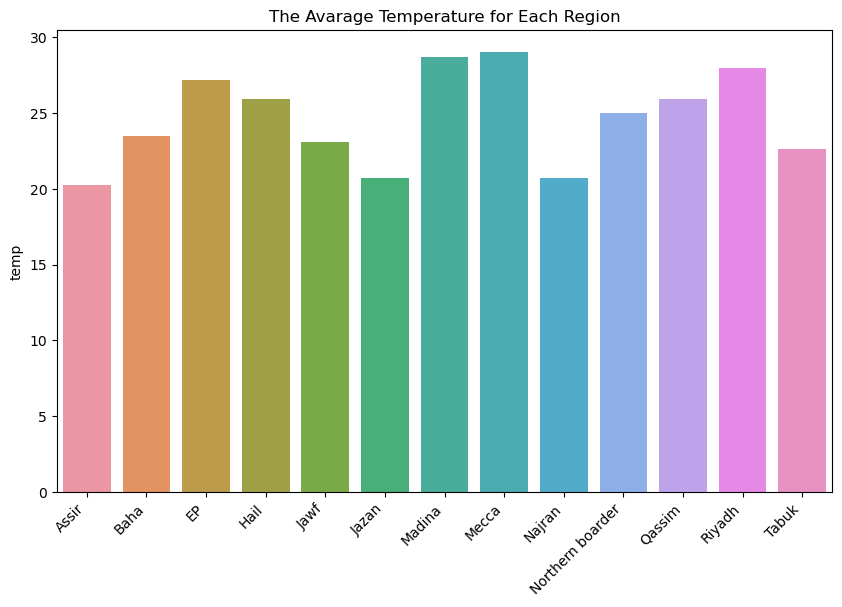

In [93]:
mean = df.groupby(['city'])['temp'].mean()
cityName= ["Assir","Baha", "EP",  "Hail", "Jawf" ,"Jazan" , "Madina" ,\
           "Mecca" , "Najran" , "Northern boarder", "Qassim" , "Riyadh" , "Tabuk"]

plt.figure(figsize=(10,6))
sns.barplot(x = cityName,y= mean)
plt.xticks(rotation=45, ha='right')
plt.xlabel=('City')
plt.ylabel=('Temperature')
plt.title("The Avarage Temperature for Each Region")
plt.show()

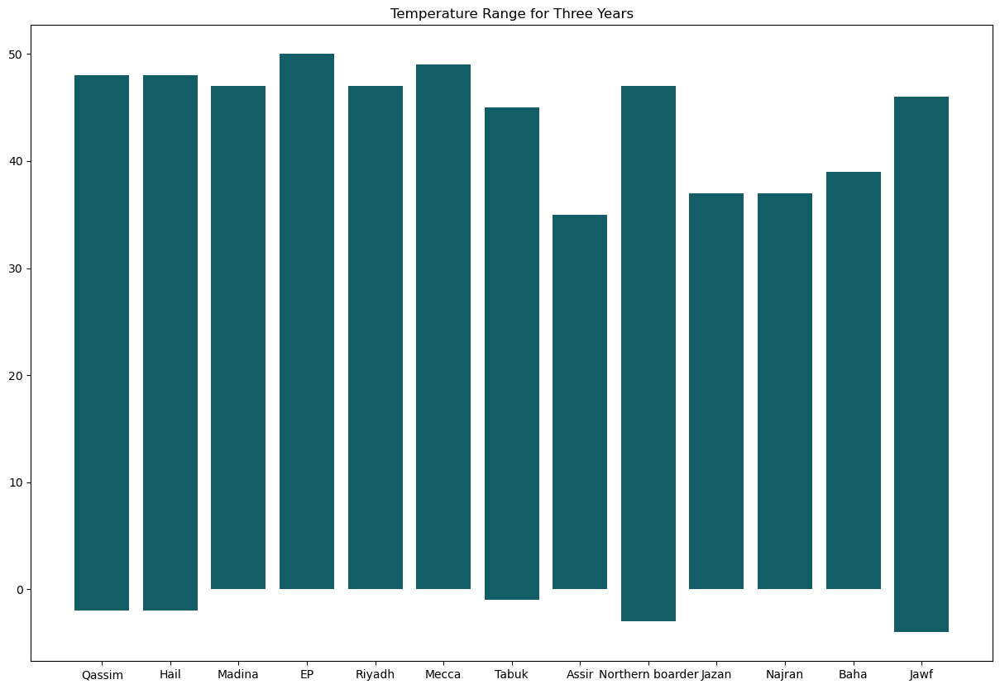

In [94]:
plt.figure(figsize = (15,10))
plt.bar( x = df["city"] , height= df["temp"])
plt.title("Temperature Range for Three Years")
plt.xlabel=('Region')
plt.ylabel=('Temperature')
plt.show()

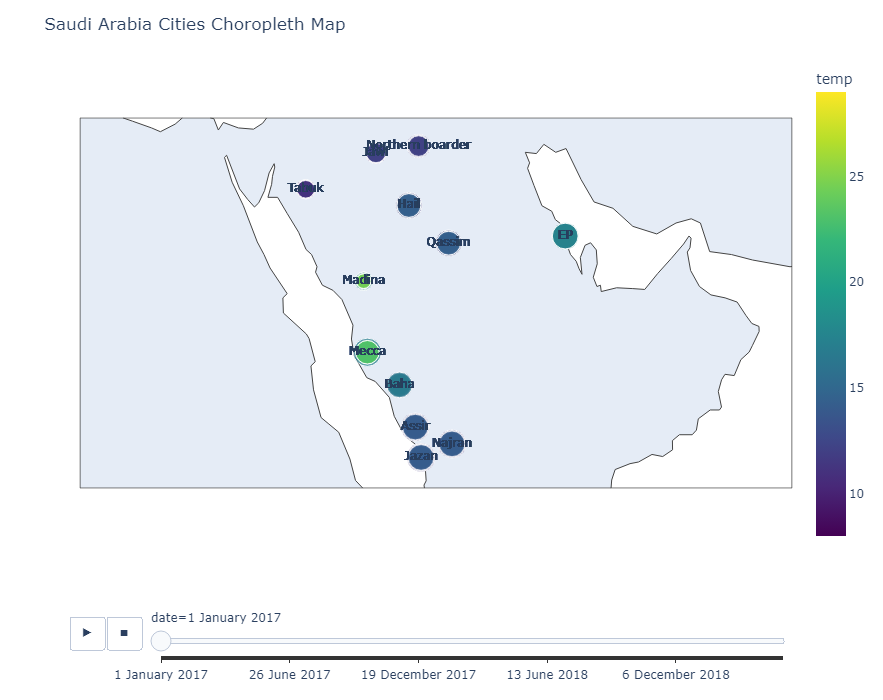

In [95]:
fig = px.scatter_geo(df, lat=df["lat"] , lon=df["lon"], text=df["city"],
                     color=df["temp"], size=df["humidity"], 
                     projection="natural earth",color_continuous_scale="Viridis",
                     animation_frame=df["date"])

fig.update_geos(fitbounds="locations", visible=True)
fig.update_layout(title="Saudi Arabia Cities Choropleth Map" , width=900, height=700 )
fig.show()


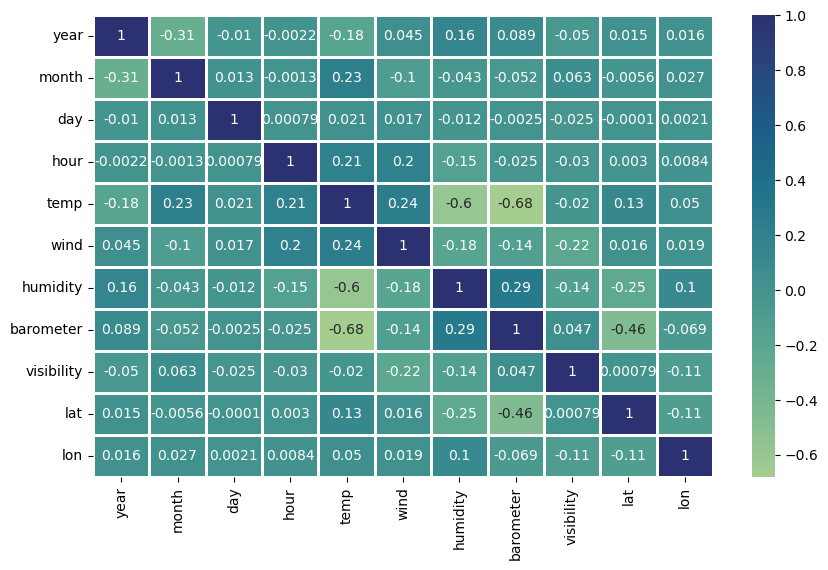

In [96]:
numeric_df = df.select_dtypes(include=['number'])
plt.figure(figsize=(10, 6))
sns.heatmap(numeric_df.corr(), linewidths=1,cmap="crest", annot=True)
plt.show()

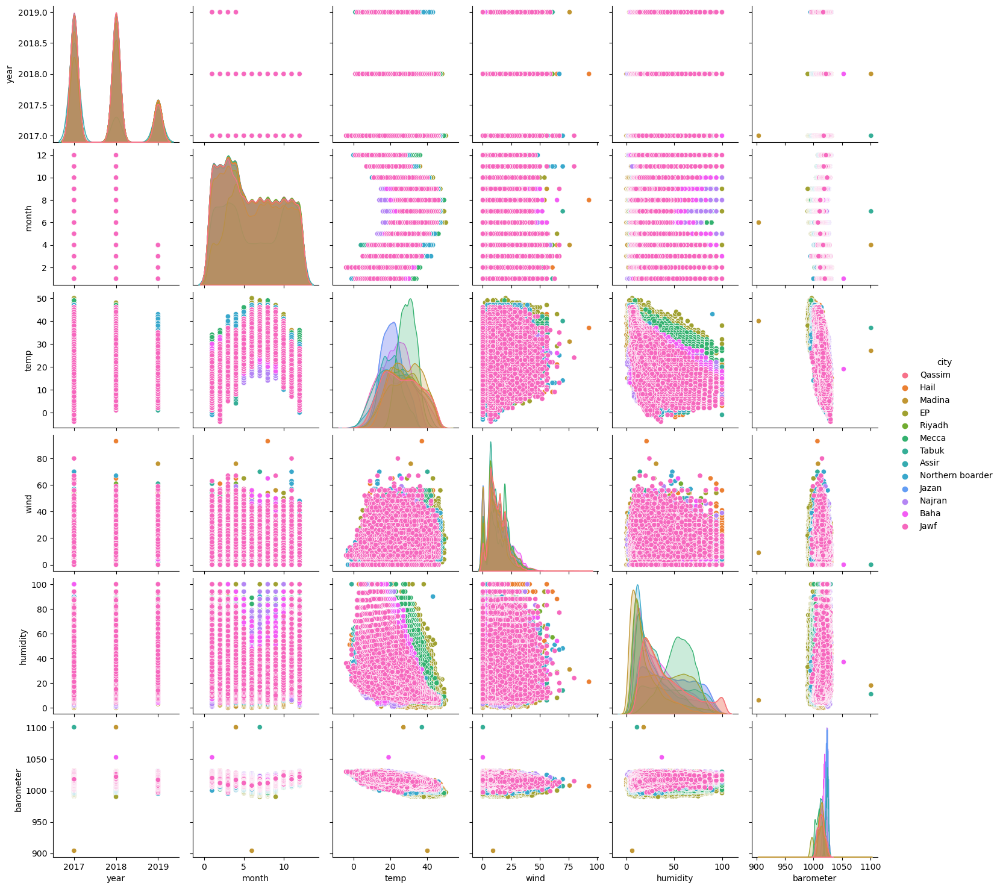

In [97]:
dff = df[["city" , "year" ,"month", "temp" ,"wind" ,"humidity" ,"barometer"]]
sns.pairplot(dff, hue="city" )
plt.show()

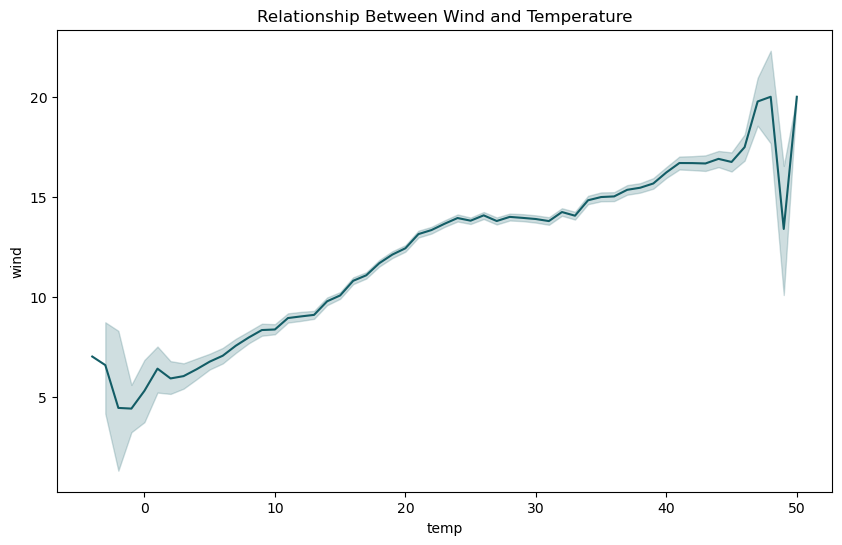

In [98]:
plt.figure(figsize=(10,6))

sns.lineplot(x=df["temp"], y=df["wind"])
plt.title('Relationship Between Wind and Temperature')
plt.show()

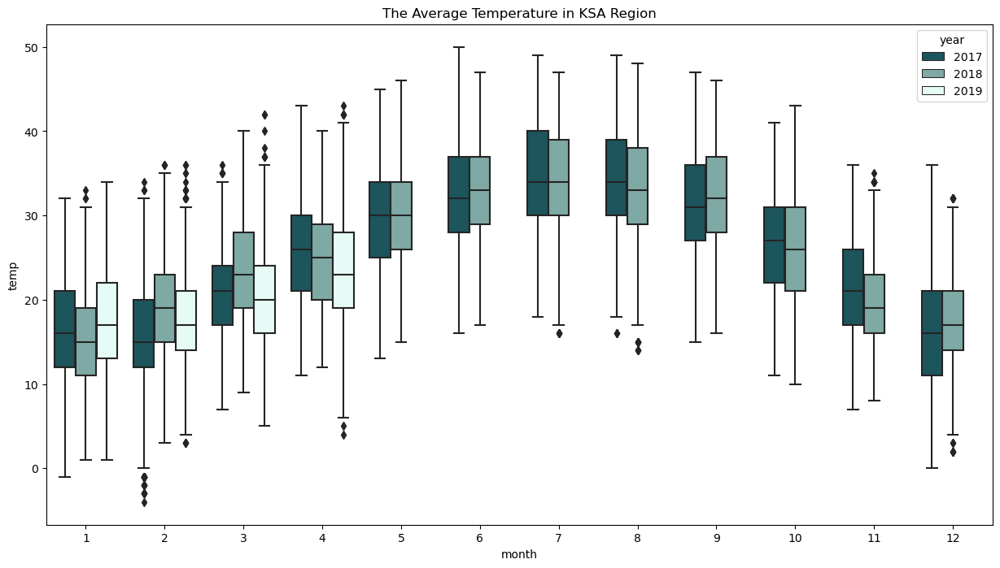

In [99]:
plt.figure(figsize=(15,8))
sns.boxplot(x="month",y="temp",hue="year",data=df)
plt.title('The Average Temperature in KSA Region')
plt.show()

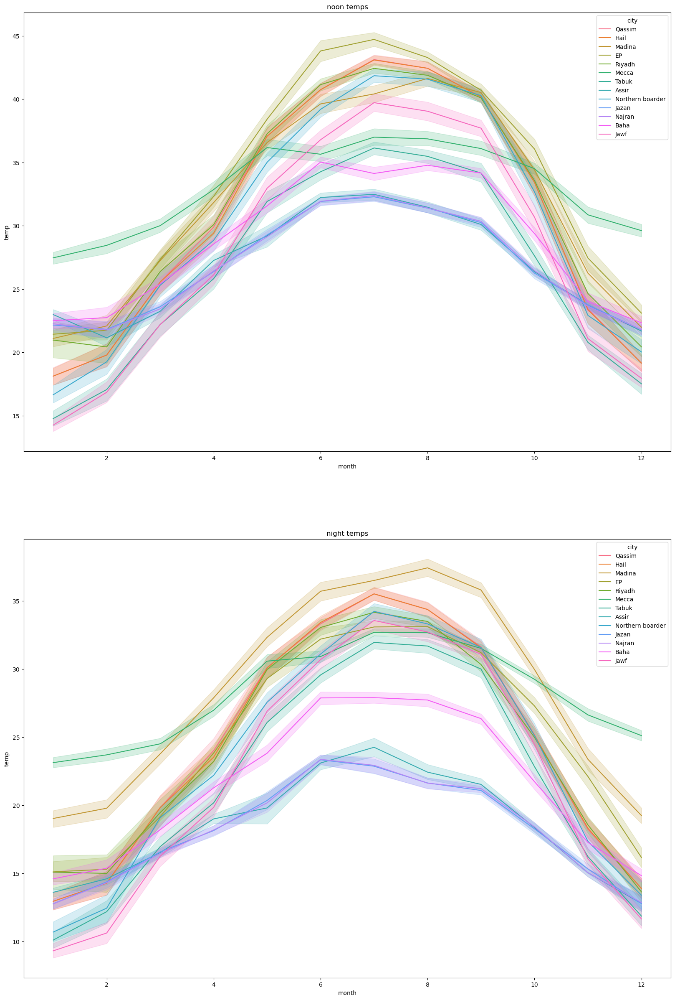

In [100]:
dfnoon = df[df["hour"] == 12]
dfnight = df[df["hour"] == 24]

fig, axs = plt.subplots(nrows=2, figsize=(20, 30))
sns.lineplot(ax = axs[0],x = dfnoon["month"], y = dfnoon["temp"], hue= dfnoon["city"])
axs[0].set_title('noon temps')

sns.lineplot(ax = axs[1],x = dfnight["month"], y = dfnight["temp"], hue= dfnight["city"])
axs[1].set_title('night temps')

plt.show();

TypeError: 'str' object is not callable

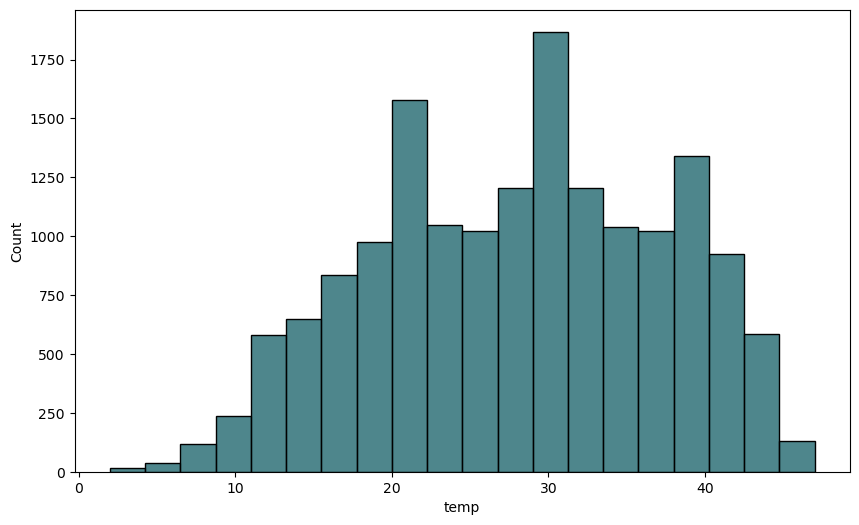

In [101]:
dfR = df[df["city"] == "Riyadh"]
plt.figure(figsize=(10,6))
sns.histplot(dfR["temp"],bins=20)
plt.xlabel('Temperature')
plt.ylabel ('Frequency')
plt.title('Temperature Distribution in Riyadh')
plt.show();

In [ ]:
plt.figure(figsize = (10,6))
plt.bar( x = dfR["month"] , height= dfR["temp"])
plt.title("Temperature Range in Riyadh")
plt.xlabel('Months')
plt.ylabel('Temperature')
plt.show()

In [ ]:
plt.figure(figsize=(15,8))
sns.boxplot(x="month",y="temp",hue="year",data=dfR)
plt.title('The Average Temperature in Riyadh')
plt.show()